In [15]:
import numpy as np

#self written libraries
from model_builder import ModelBuild
from data_prep import DataPrep
from lime_evaluator import Lime_eval

#other libraries
from sklearn.model_selection import train_test_split
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
# pandas concat in lime_evaluator

In [16]:
data_location = "./data/compas-scores-two-years.csv"
compas_score_full = pd.read_csv(data_location)
data_prepper = DataPrep(compas_score_full)
X, y, X_cols = data_prepper.get()

features = [c for c in X]

categorical_feature_name = ['two_year_recid', 'c_charge_degree_F', 'c_charge_degree_M',\
                            'sex_Female', 'sex_Male', 'race']

categorical_feature_indcs = [features.index(c) for c in categorical_feature_name]
race_indc = features.index('race')

X=X.to_numpy()
X = X.astype(float)
y=np.array(y)

Accuracy: 0.7676113360323886


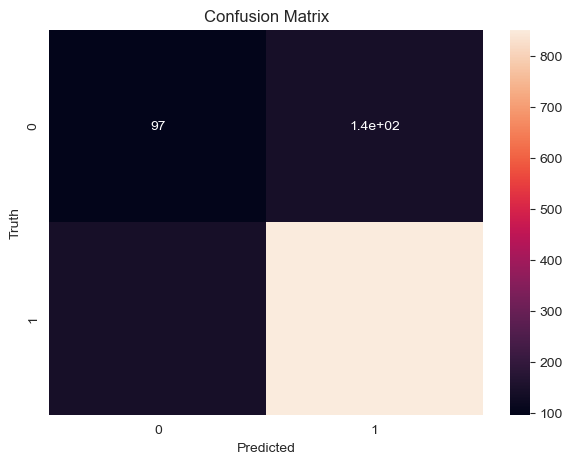

In [17]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, test_size=0.2, random_state=32, shuffle=True)
modelBuilder = ModelBuild('DecisionTree')
model, accuracy, cm = modelBuilder.train_eval(X_train, y_train, X_test, y_test)

print(f"Accuracy: {accuracy}")
plt.figure(figsize=(7,5))
sns.heatmap(cm, annot=True)
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('Truth')
plt.show()

In [18]:
#instance to explain (for easy column viewing converted to pandas)
print(f"Instance to be explained:\n{pd.DataFrame(X_test, columns=X_cols).iloc[0]}")
print(f"Instance to be explained as list: {X_test[0]}")

Instance to be explained:
age                  34.0
two_year_recid        1.0
priors_count          0.0
length_of_stay        2.0
c_charge_degree_F     1.0
c_charge_degree_M     0.0
sex_Female            0.0
sex_Male              1.0
race                  0.0
Name: 0, dtype: float64
Instance to be explained as list: [34.  1.  0.  2.  1.  0.  0.  1.  0.]


# original LIME

In [19]:
import lime.lime_tabular
sample_size = 50
explainer_lime = lime.lime_tabular.LimeTabularExplainer(X_train, feature_names=X_cols, class_names=['0', '1'], discretize_continuous=True)

exp_inst = explainer_lime.explain_instance(X_test[0], model.predict_proba, num_features=7)
exp_inst.show_in_notebook()
df0 = Lime_eval.evaluate_stability(X_test[0], model.predict_proba, explainer_lime, sample_size, experiment=0)

# Train SOM and explain with SOMLIME

# Experiment 1 
Distance between centroids 

Instance to be explained:
age                  34.0
two_year_recid        1.0
priors_count          0.0
length_of_stay        2.0
c_charge_degree_F     1.0
c_charge_degree_M     0.0
sex_Female            0.0
sex_Male              1.0
race                  0.0
Name: 0, dtype: float64
Instance to be explained as list: [34.  1.  0.  2.  1.  0.  0.  1.  0.]


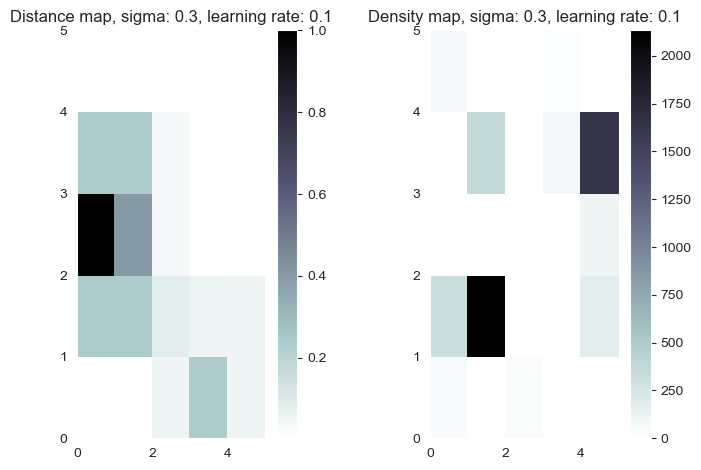

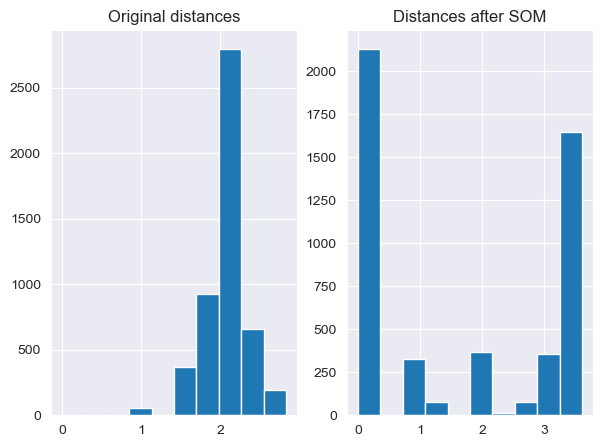


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 432.8232   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


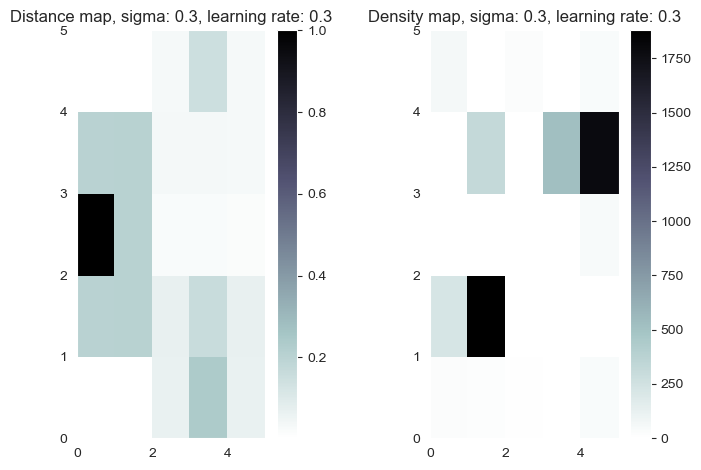

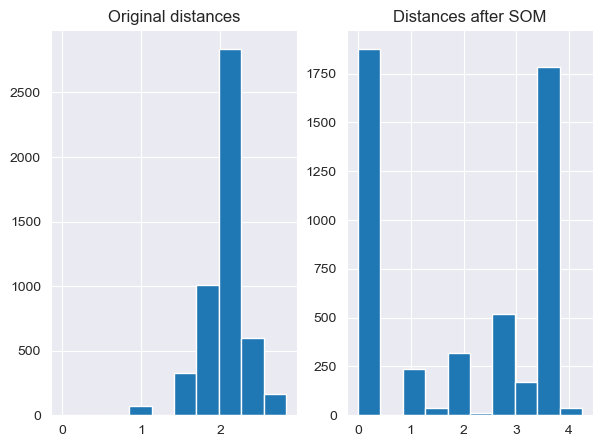


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 272.8201   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


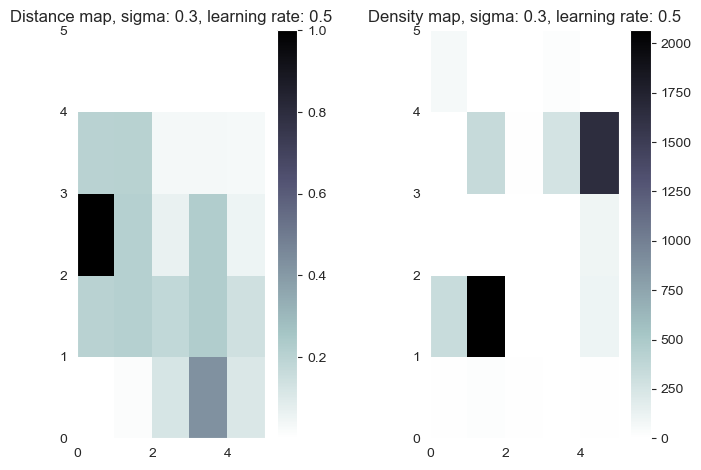

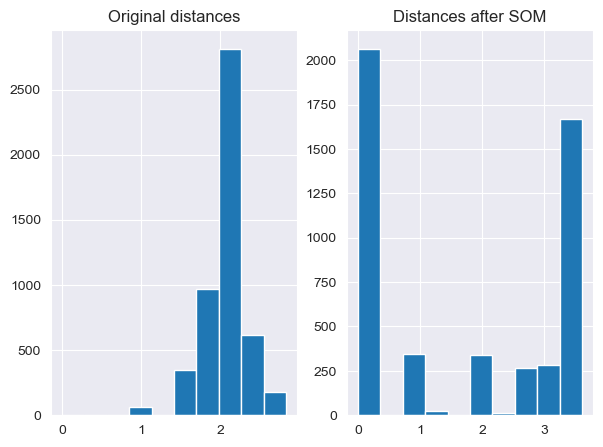


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 299.3981   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


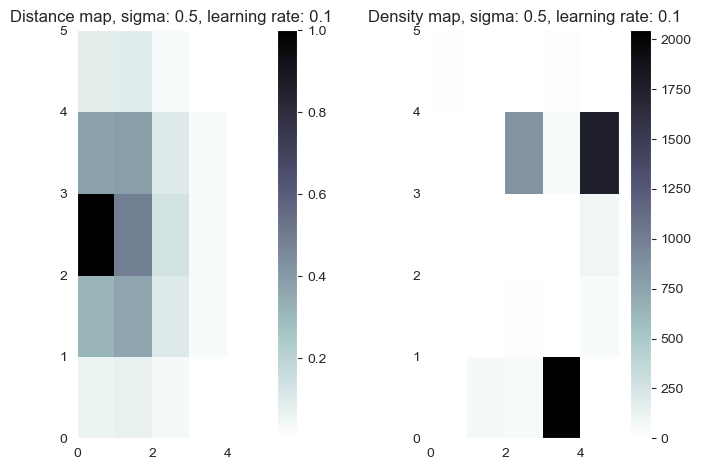

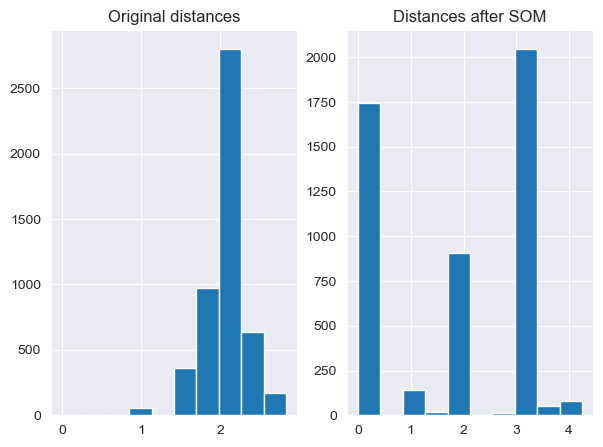


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 401.4580   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


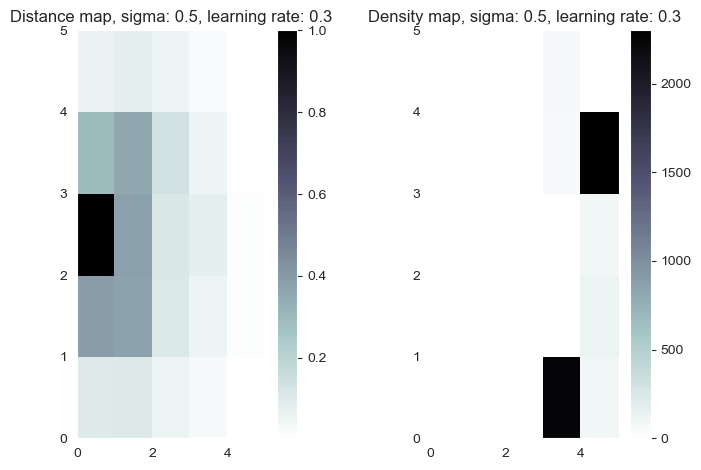

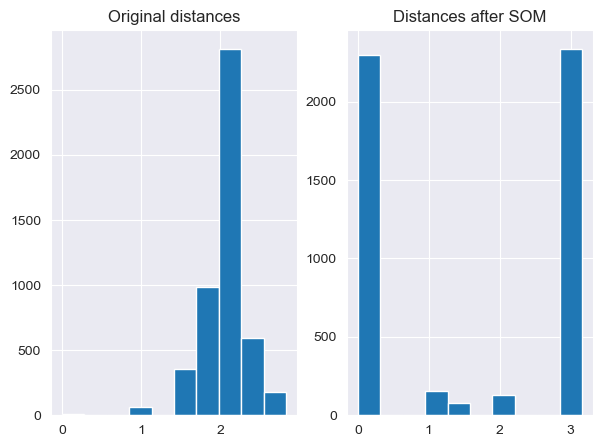


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 281.3205   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


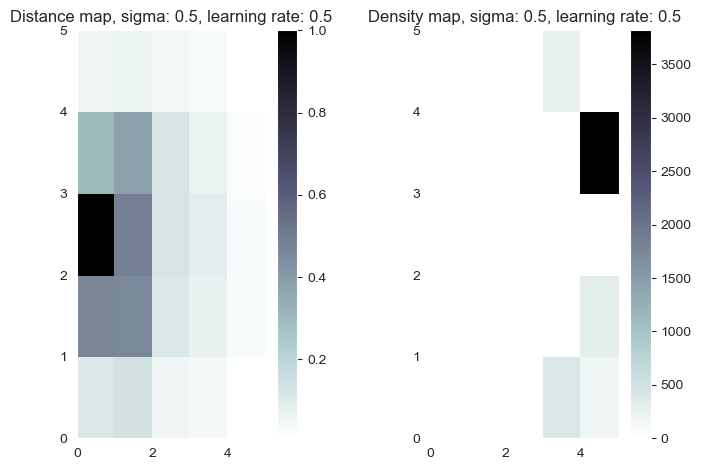

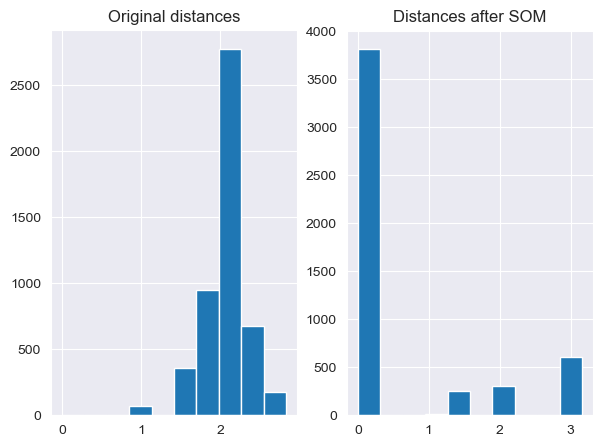


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 118.4590   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


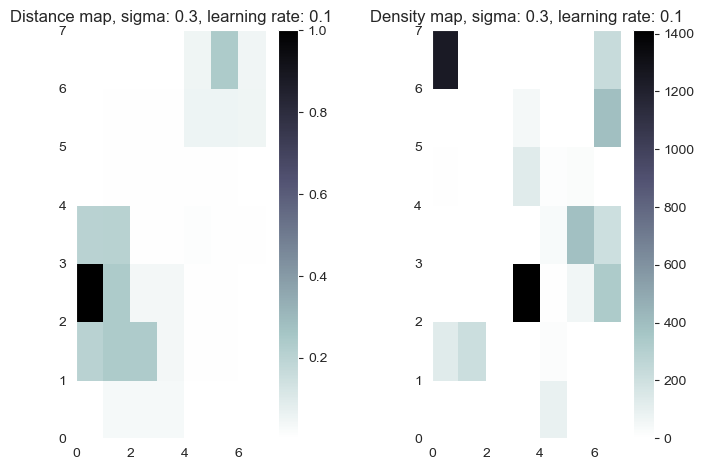

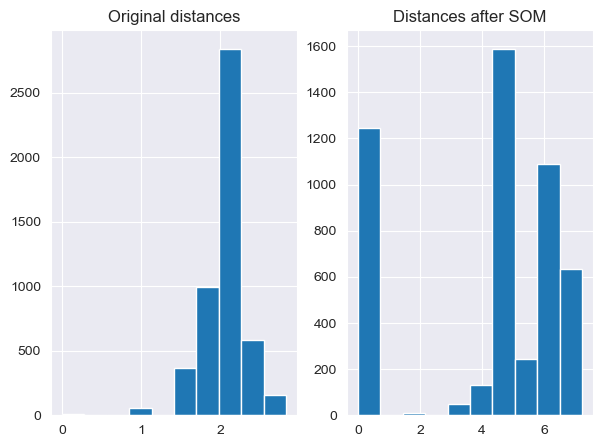


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 321.9597   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


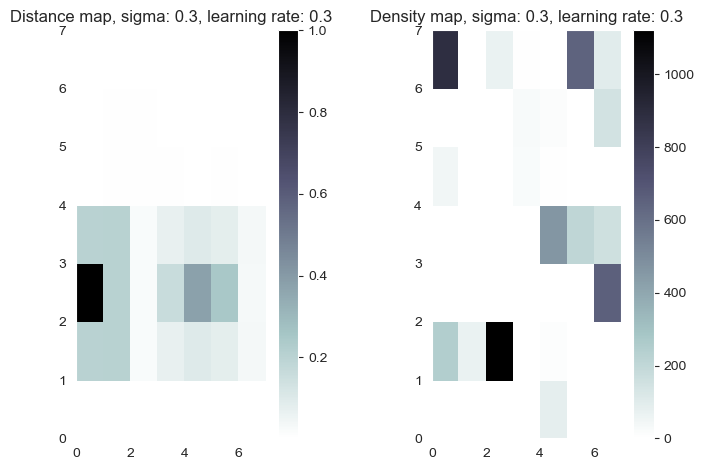

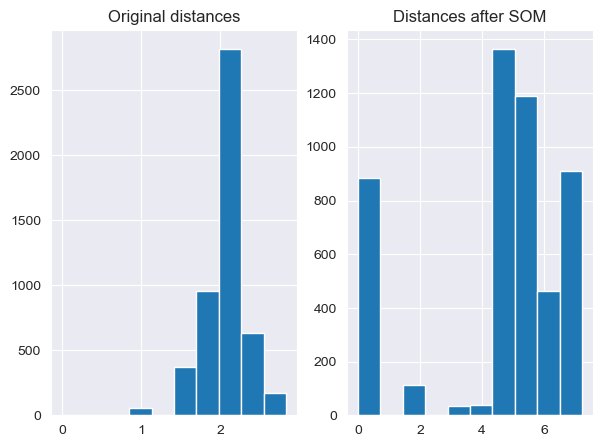


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 789.4925   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


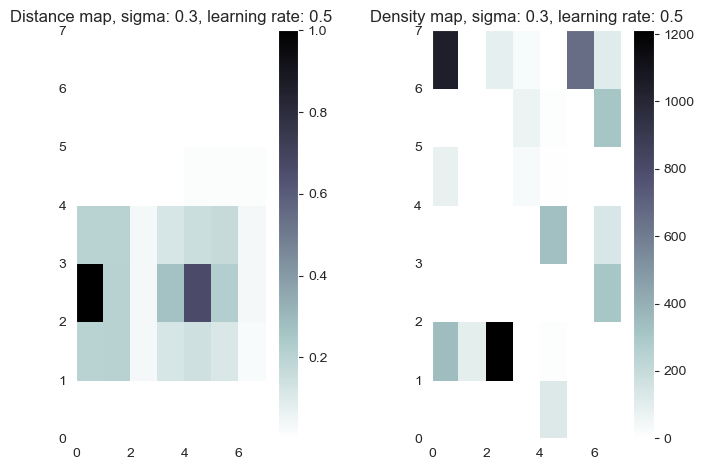

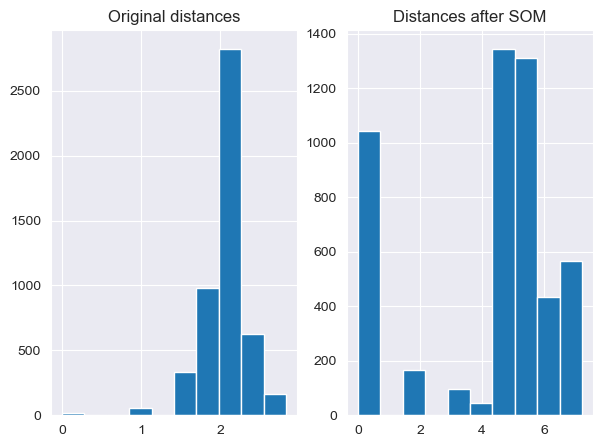


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 624.6930   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


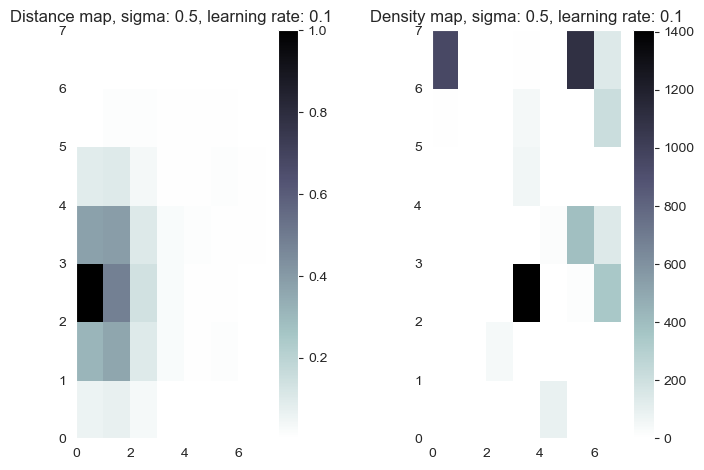

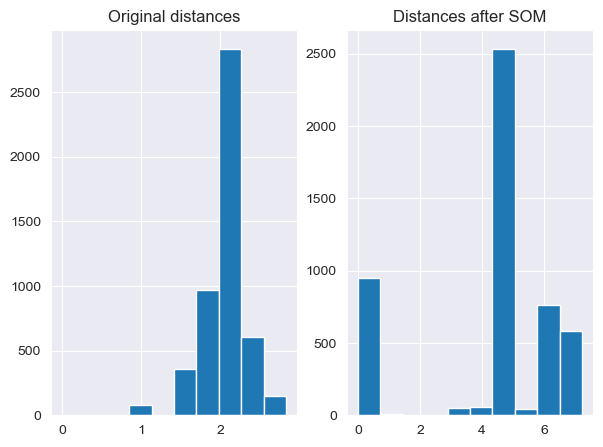


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 779.4081   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


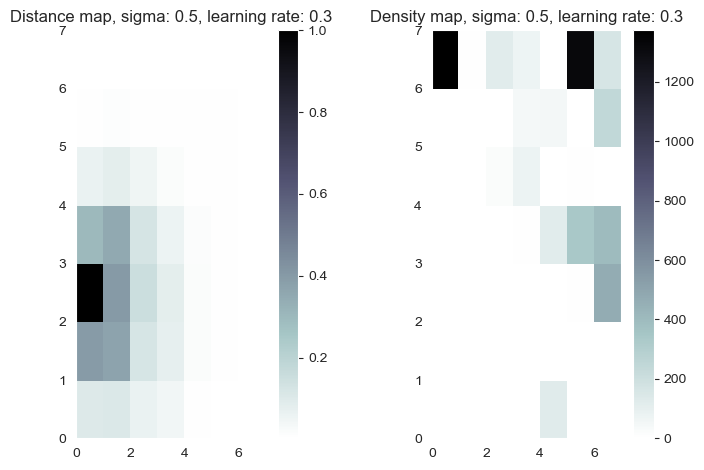

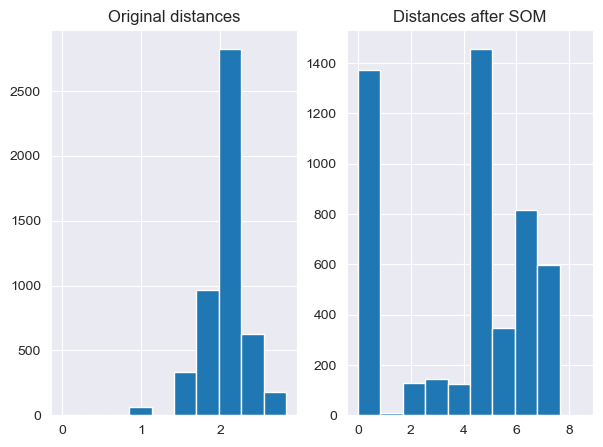


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 647.9748   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


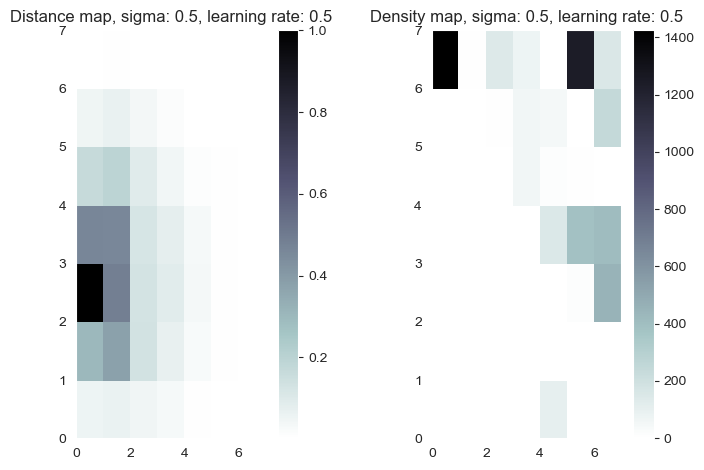

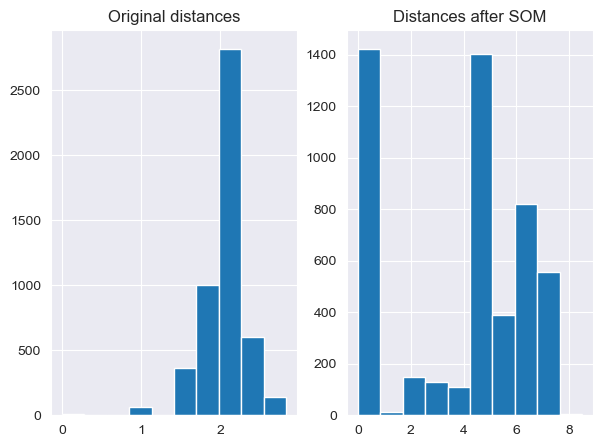


Experiment squared mean
-------------------------
Significant Results:
mean                                F-statistic = 488.1725   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:


In [20]:
from somlime import som
explainer_lime = modelBuilder.som_explain(X_train, X_cols)

#instance to explain (for easy column viewing converted to pandas)
print(f"Instance to be explained:\n{pd.DataFrame(X_test, columns=X_cols).iloc[0]}")
print(f"Instance to be explained as list: {X_test[0]}")

some_shape_list = [(5,5), (7,7)]
sigma_list = [0.3, 0.5]
learning_rate_list = [0.1, 0.3, 0.5]
for sh in some_shape_list:
    for s in sigma_list:
        for l in learning_rate_list:
            som_model = som.SOM(sh , X_train.shape[1], sigma=s, learning_rate=l)
            som_model.train(X_train, 1000)

            exp_inst = explainer_lime.explain_instance(X_test[0], model.predict_proba, som_model, num_features=5, plot=True, experiment=1)
            exp_inst.show_in_notebook()
            
            #add statistical significance tests
            df1 = Lime_eval.evaluate_stability(X_test[0], model.predict_proba, explainer_lime, som_model, sample_size, experiment=1)
            Lime_eval.compare_experiments(df0, df1, all=False, mean=True)

# Experiment 2
Distance between centroids + euclidean distance 


Instance to be explained:
age                  34.0
two_year_recid        1.0
priors_count          0.0
length_of_stay        2.0
c_charge_degree_F     1.0
c_charge_degree_M     0.0
sex_Female            0.0
sex_Male              1.0
race                  0.0
Name: 0, dtype: float64
Instance to be explained as list: [34.  1.  0.  2.  1.  0.  0.  1.  0.]


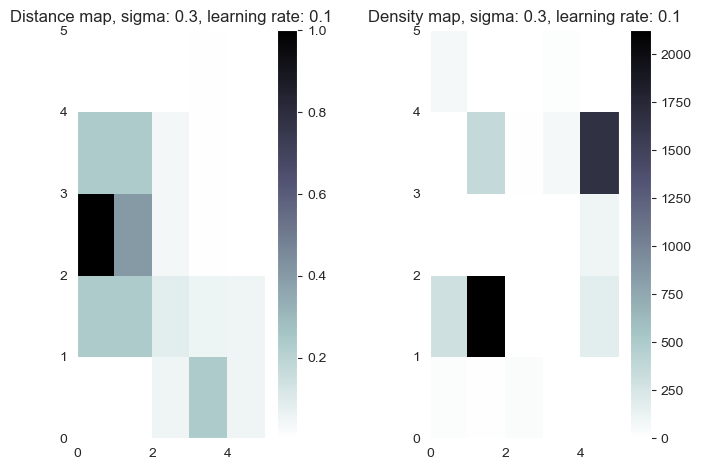

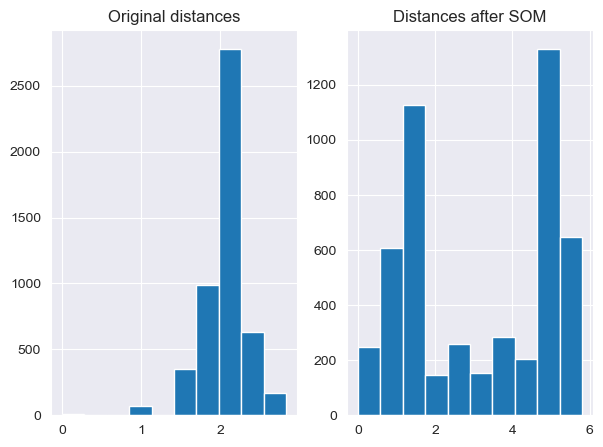

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1288.7049  p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 41.2991    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 0.7696     p-value = 0.382479   Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

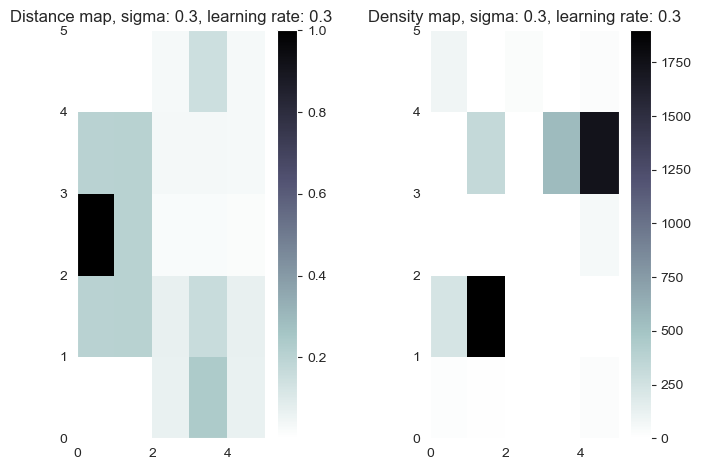

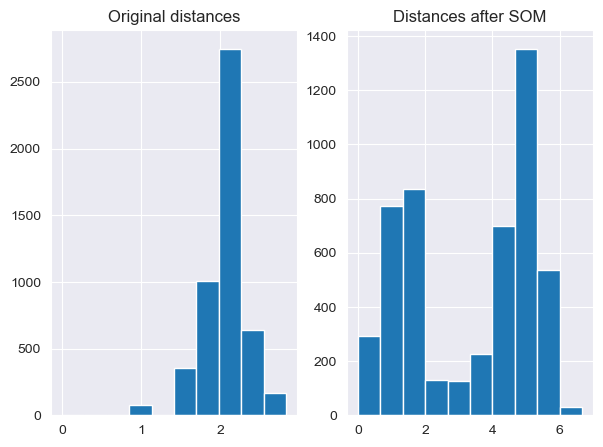

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1392.6198  p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 13.6715    p-value = 0.000359   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 24.4907    p-value = 0.000003   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

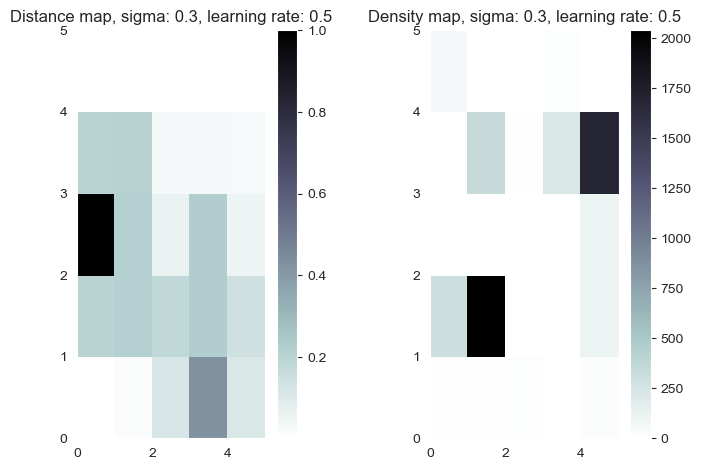

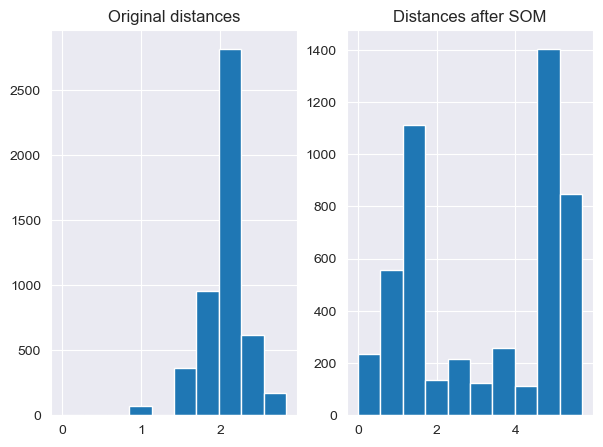

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1221.4462  p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 50.3251    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 0.7184     p-value = 0.398728   Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

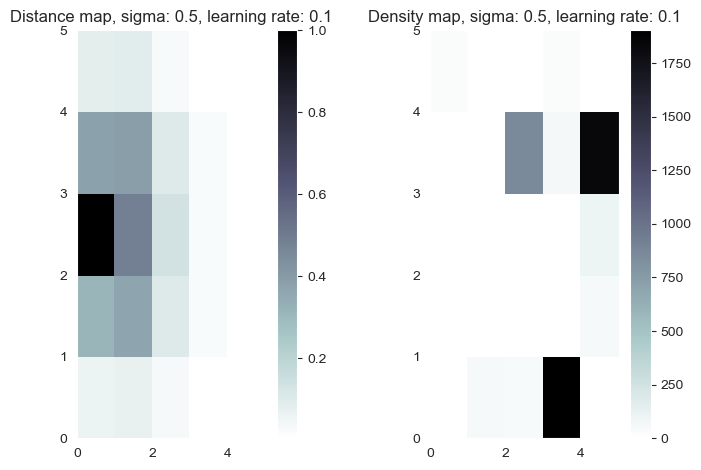

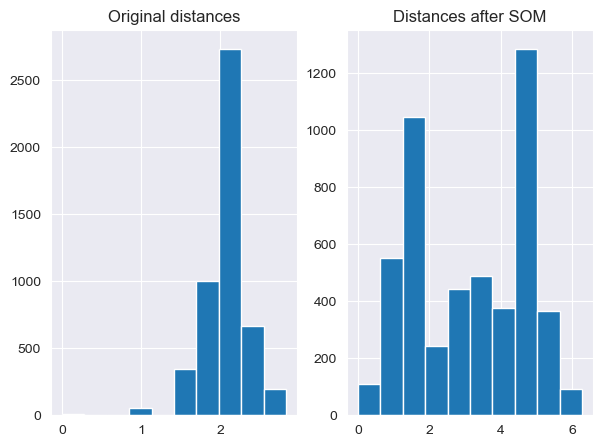

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 402.1385   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 133.8357   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 3.5201     p-value = 0.063604   Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

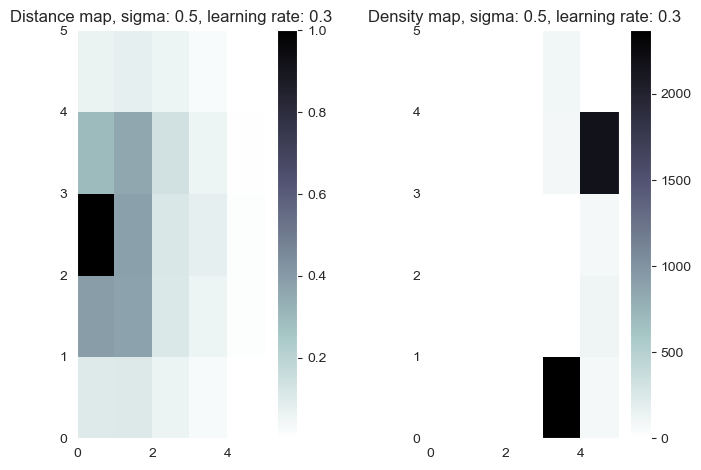

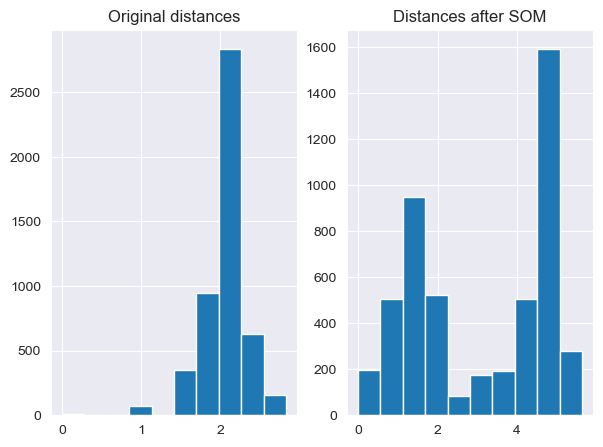

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 262.5632   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 152.7284   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 0.5756     p-value = 0.449851   Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

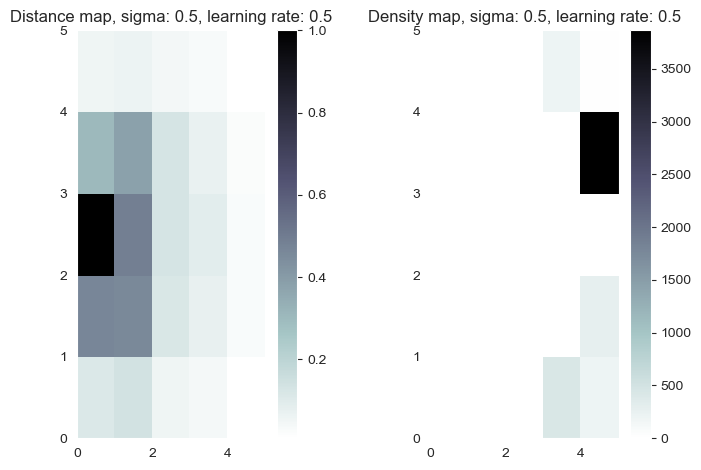

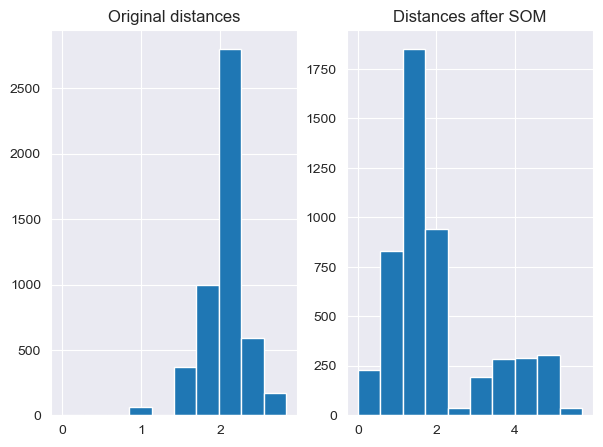

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 59.2029    p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 21.4779    p-value = 0.000011   Variance is LOWER in modified experiment
race <= 0.00                        F-statistic = 38.5143    p-value = 0.000000   Variance is LOWER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is LOWER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is LOWER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                  F-s

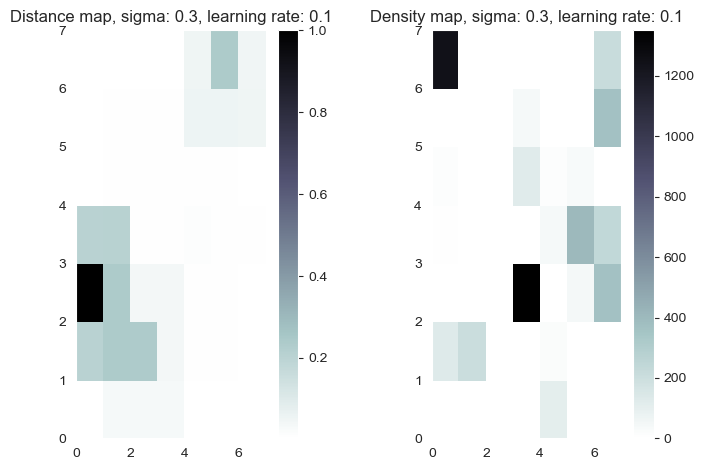

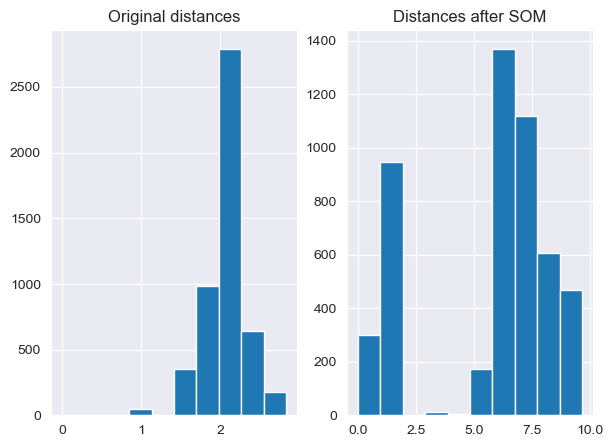

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 925.5011   p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 28.8259    p-value = 0.000001   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 214.4709   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

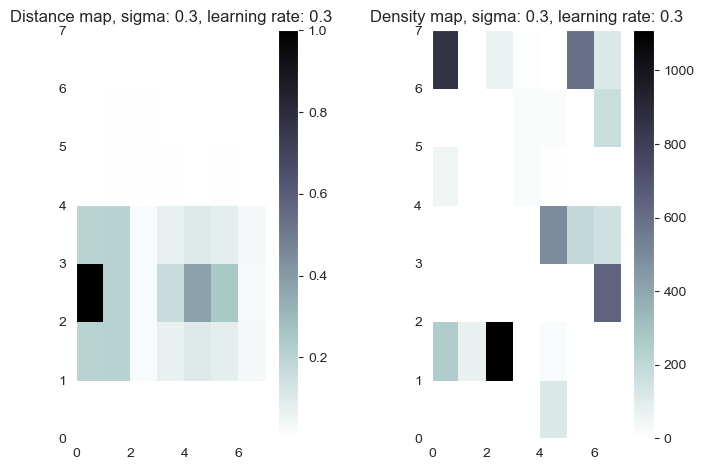

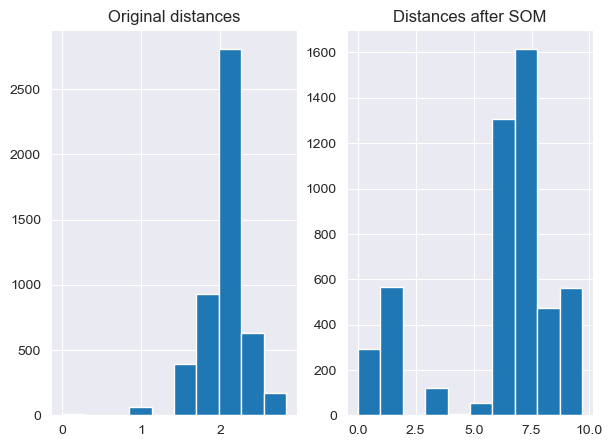

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 3402.6060  p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 118.9341   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 65.5062    p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 246.6182   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

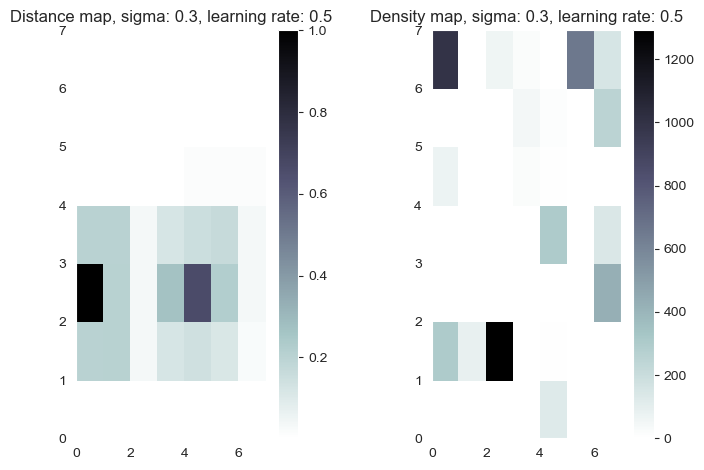

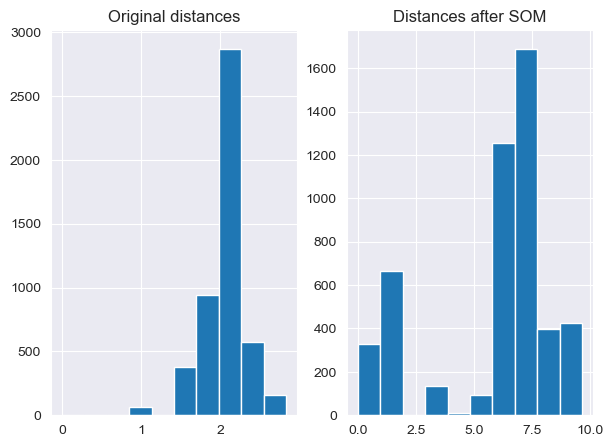

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 643.3799   p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 38.0580    p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 260.7510   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 248.2453   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

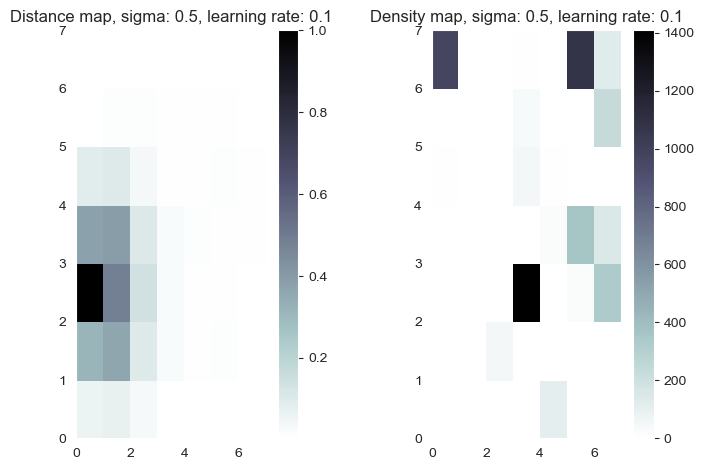

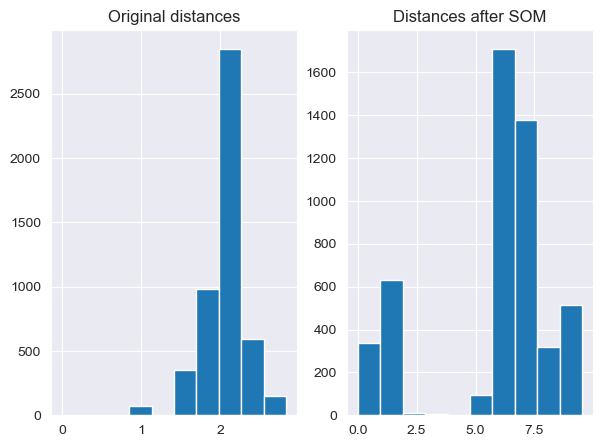

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 4461.6990  p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 29.2742    p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 101.9814   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

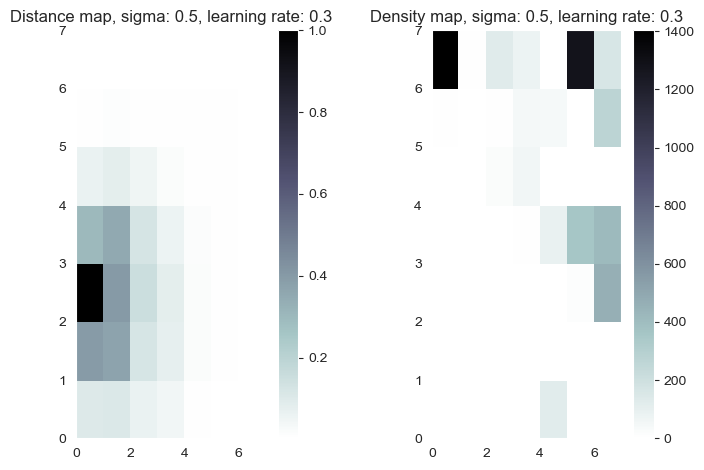

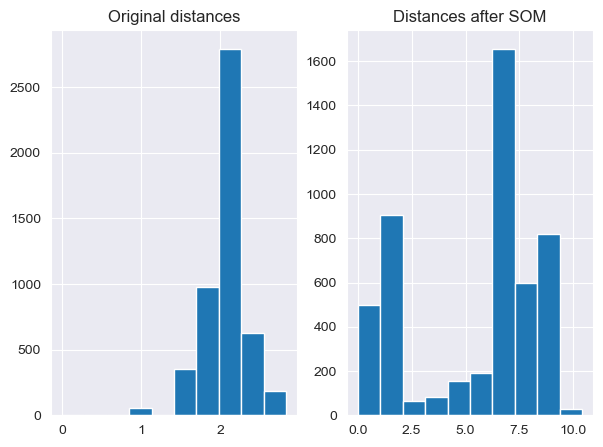

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 256.1454   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 78.8456    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

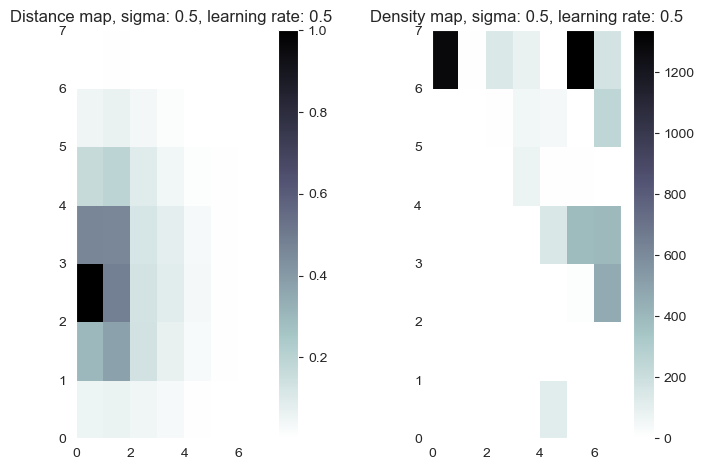

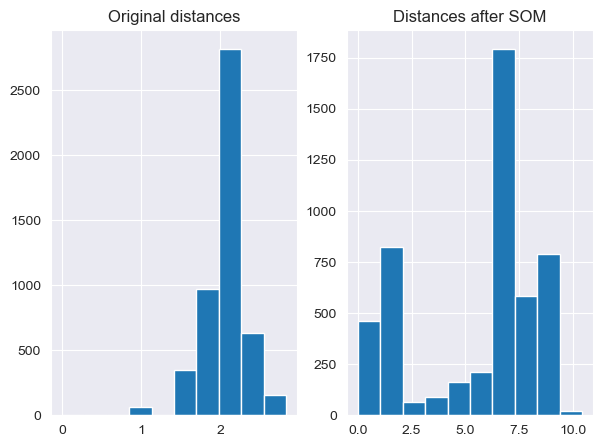

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 271.1431   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 129.9878   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

In [21]:
from somlime import som
explainer_lime = modelBuilder.som_explain(X_train, X_cols)

#instance to explain (for easy column viewing converted to pandas)
print(f"Instance to be explained:\n{pd.DataFrame(X_test, columns=X_cols).iloc[0]}")

some_shape_list = [(5,5), (7,7)]
sigma_list = [0.3, 0.5]
learning_rate_list = [0.1, 0.3, 0.5]
for sh in some_shape_list:
    for s in sigma_list:
        for l in learning_rate_list:
            som_model = som.SOM(sh , X_train.shape[1], sigma=s, learning_rate=l)
            som_model.train(X_train, 1000)

            print(f"Instance to be explained as list: {X_test[0]}")
            exp_inst = explainer_lime.explain_instance(X_test[0], model.predict_proba, som_model, num_features=5, plot=True, experiment=2)
            exp_inst.show_in_notebook()
            
            #add statistical significance tests
            df1 = Lime_eval.evaluate_stability(X_test[0], model.predict_proba, explainer_lime, som_model, sample_size, experiment=1)
            Lime_eval.compare_experiments(df0, df1, all=True, mean=True)

# Experiment 3

Euclidean distance for instances in the same cluster of instances to explain, 10 is for istances that are out of cluster 



Instance to be explained:
age                  34.0
two_year_recid        1.0
priors_count          0.0
length_of_stay        2.0
c_charge_degree_F     1.0
c_charge_degree_M     0.0
sex_Female            0.0
sex_Male              1.0
race                  0.0
Name: 0, dtype: float64
Instance to be explained as list: [34.  1.  0.  2.  1.  0.  0.  1.  0.]


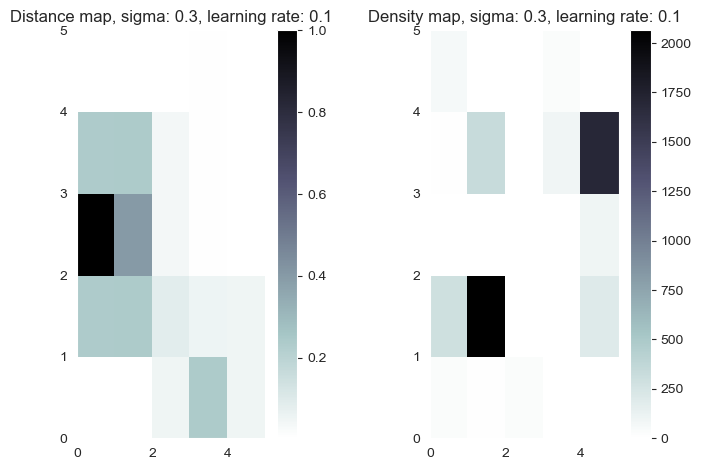

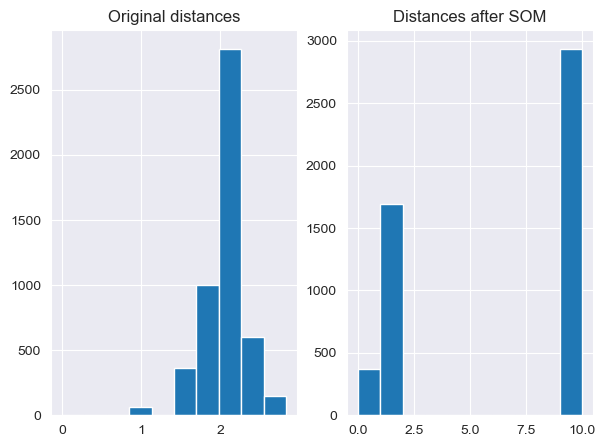

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1284.6824  p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 16.9551    p-value = 0.000080   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 2.0740     p-value = 0.153013   Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

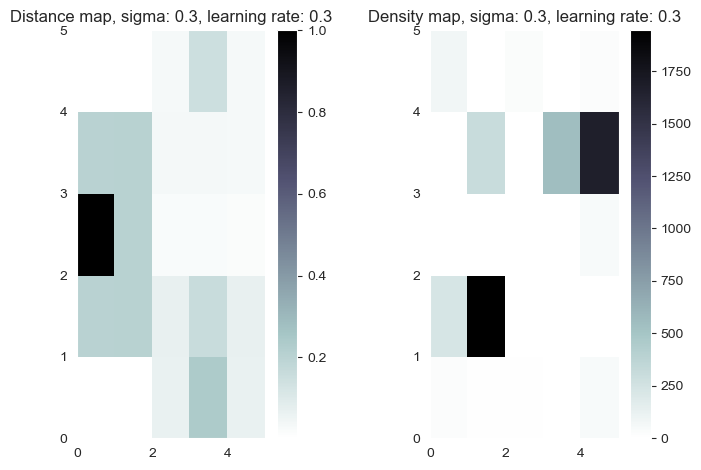

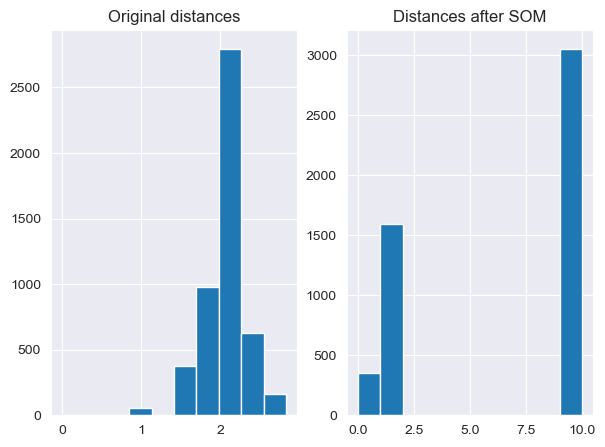

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 889.1398   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 35.1593    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 2.2860     p-value = 0.133760   Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

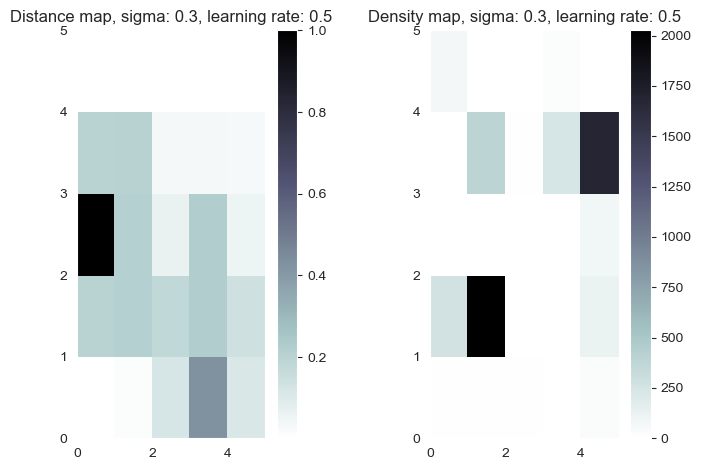

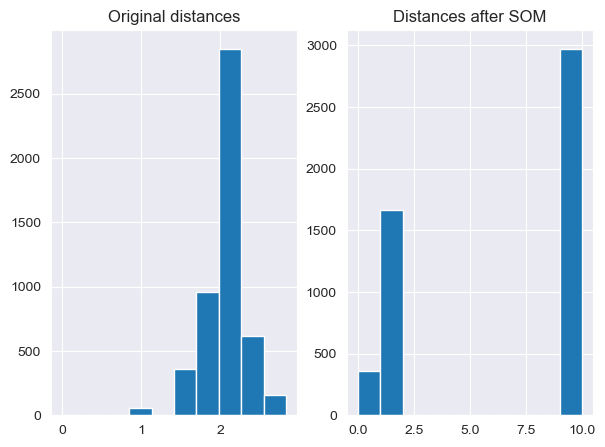

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1337.9699  p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 45.4218    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 0.2592     p-value = 0.611813   Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

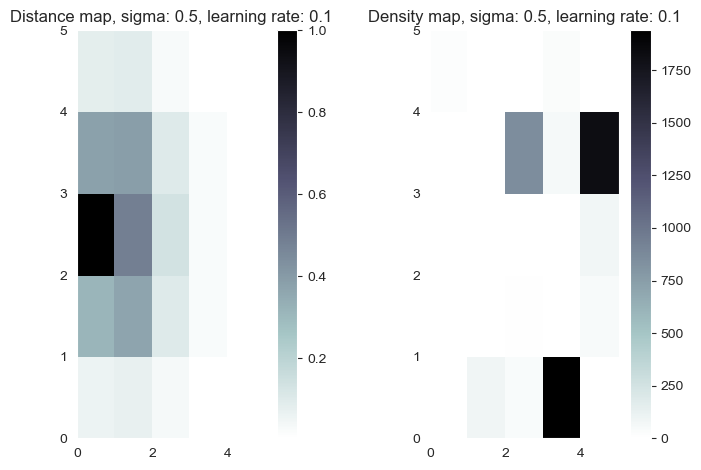

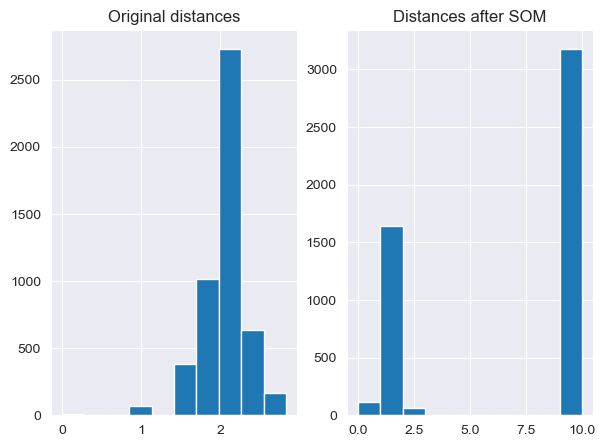

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 154.7009   p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 364.2993   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 105.1642   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 1.6602     p-value = 0.200614   Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

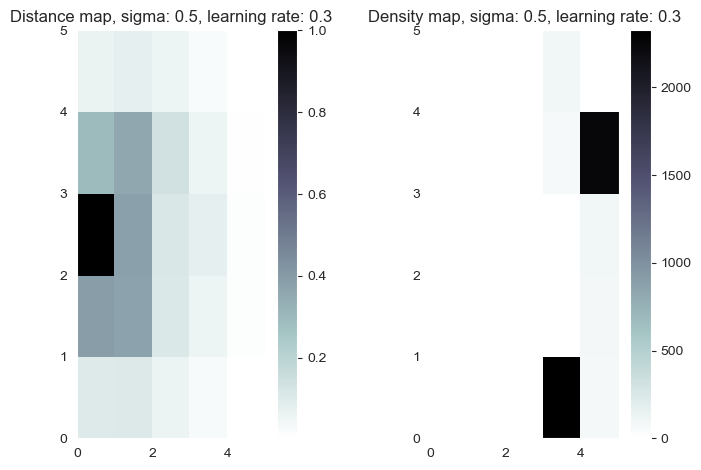

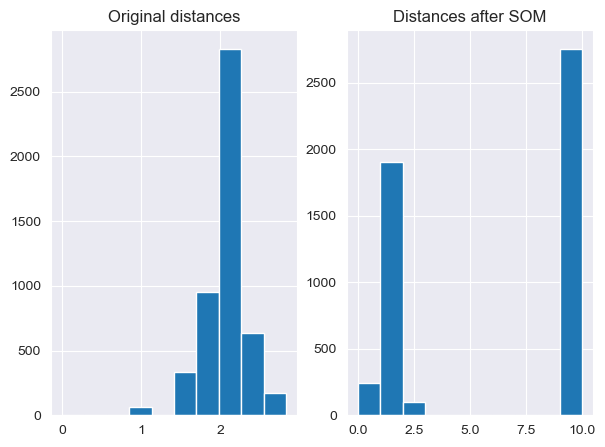

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 251.2355   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 123.2889   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 1.0303     p-value = 0.312588   Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

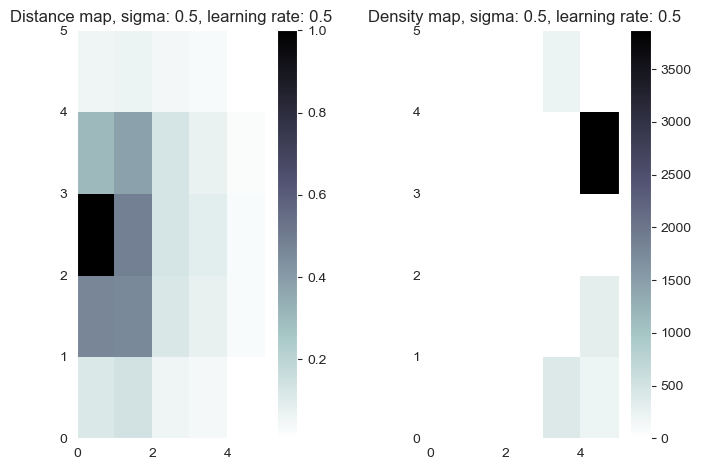

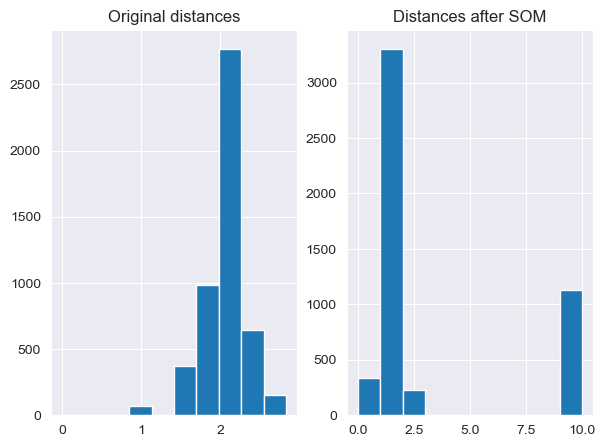

Experiment all columns:
-------------------------
Significant Results:
31.00 < age <= 42.00                F-statistic = 78.8152    p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 10.4491    p-value = 0.001672   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 49.2832    p-value = 0.000000   Variance is LOWER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
0.00 < two_year_recid <= 1.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is LOWER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                  F

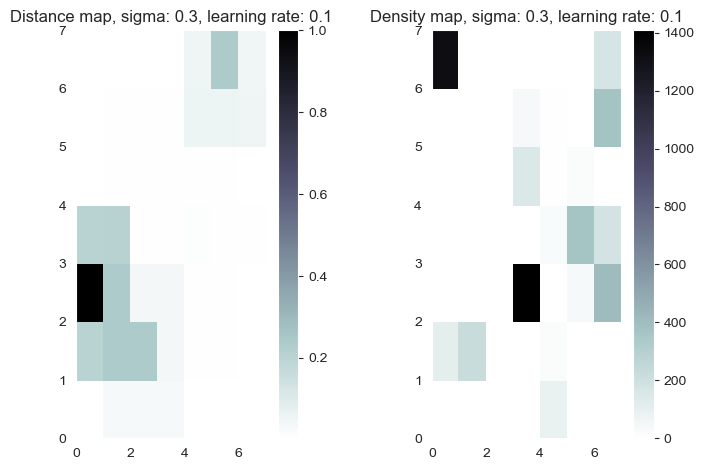

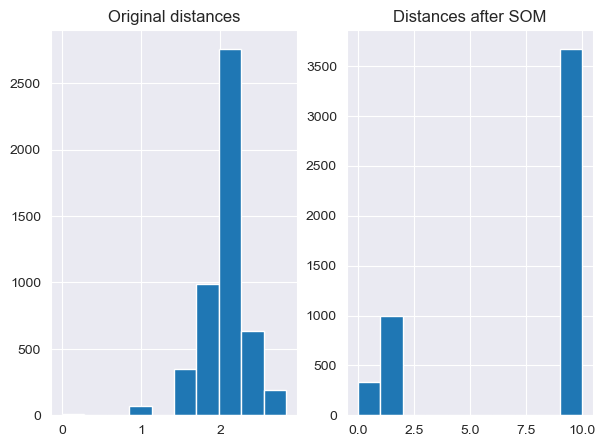

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 970.9762   p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 54.4923    p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 219.5521   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

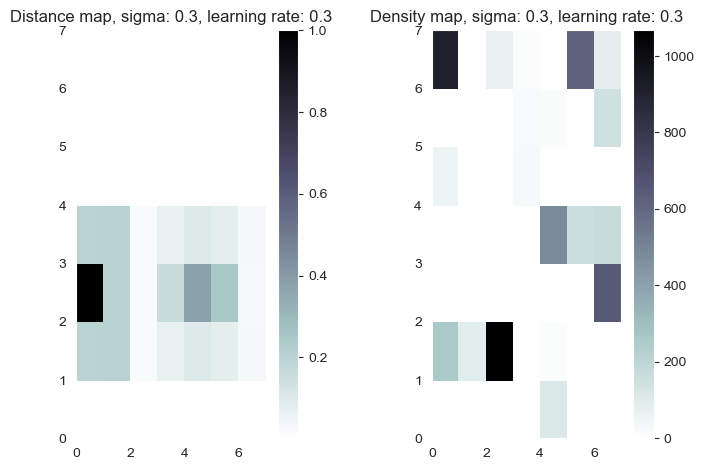

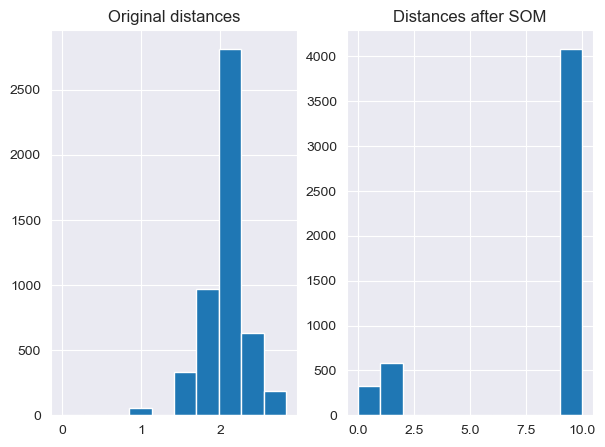

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 1595.5014  p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 116.1402   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 102.7492   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

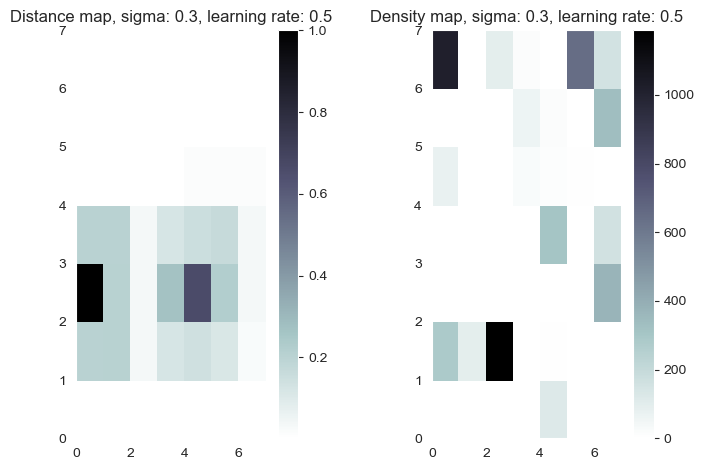

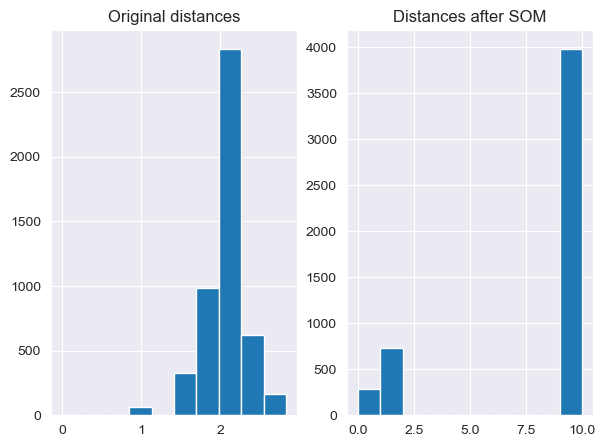

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 642.9328   p-value = 0.000000   Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = 104.2071   p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 236.1274   p-value = 0.000000   Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = 222.8884   p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

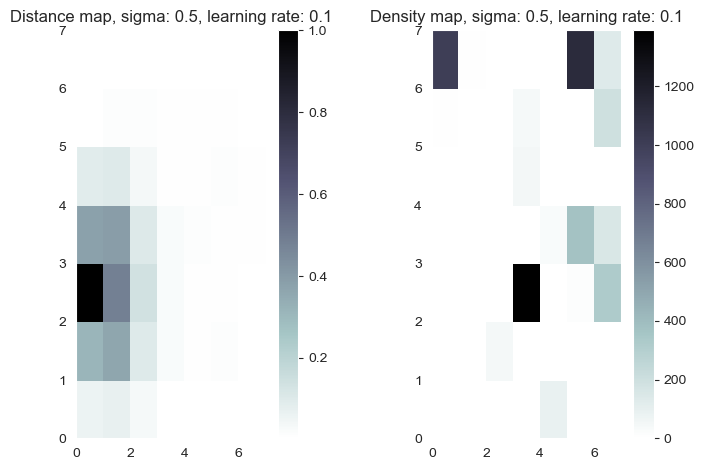

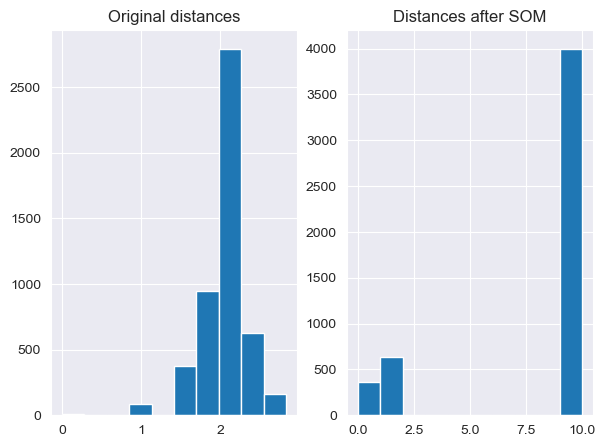

Experiment all columns:
-------------------------
Significant Results:
0.00 < two_year_recid <= 1.00       F-statistic = 2796.3597  p-value = 0.000000   Variance is HIGHER in modified experiment
priors_count <= 0.00                F-statistic = 80.7579    p-value = 0.000000   Variance is HIGHER in modified experiment

Non-Significant Results:
0.00 < c_charge_degree_F <= 1.00    F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
1.00 < length_of_stay <= 5.00       F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
31.00 < age <= 42.00                F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
c_charge_degree_M <= 0.00           F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
race <= 0.00                        F-statistic = nan        p-value = nan        Variance is HIGHER in modified experiment
sex_Female <= 0.00                 

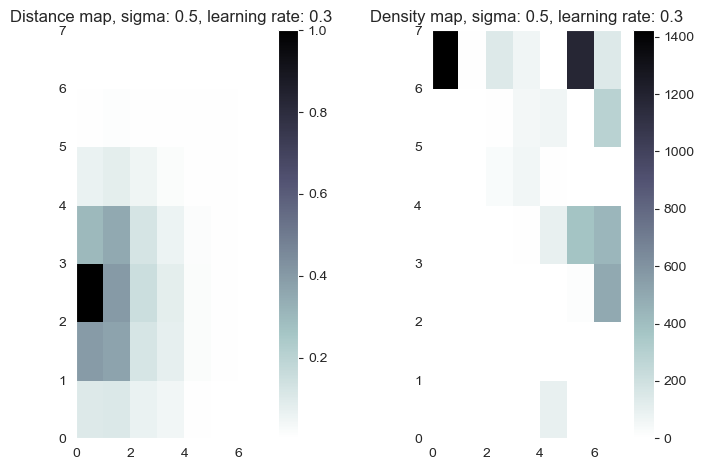

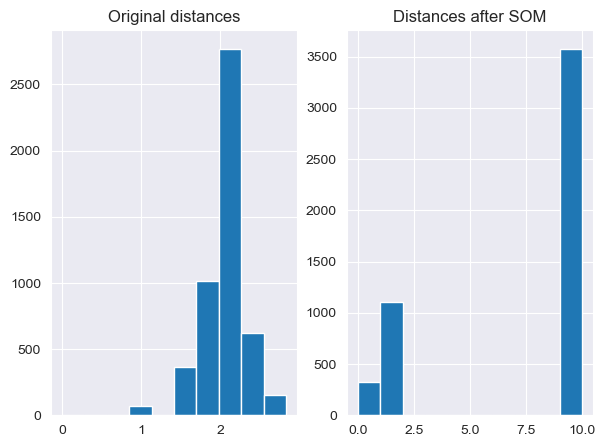

In [ ]:
from somlime import som
explainer_lime = modelBuilder.som_explain(X_train, X_cols)

#instance to explain (for easy column viewing converted to pandas)
print(f"Instance to be explained:\n{pd.DataFrame(X_test, columns=X_cols).iloc[0]}")

some_shape_list = [(5,5), (7,7)]
sigma_list = [0.3, 0.5]
learning_rate_list = [0.1, 0.3, 0.5]
for sh in some_shape_list:
    for s in sigma_list:
        for l in learning_rate_list:
            som_model = som.SOM(sh , X_train.shape[1], sigma=s, learning_rate=l)
            som_model.train(X_train, 1000)

            print(f"Instance to be explained as list: {X_test[0]}")
            exp_inst = explainer_lime.explain_instance(X_test[0], model.predict_proba, som_model, num_features=5, plot=True, experiment=3)
            exp_inst.show_in_notebook()
            
            #add statistical significance tests
            df1 = Lime_eval.evaluate_stability(X_test[0], model.predict_proba, explainer_lime, som_model, sample_size, experiment=1)
            Lime_eval.compare_experiments(df0, df1, all=True, mean=True)